In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
%matplotlib inline
%config IPython.matplotlib.backend = "retina"
from matplotlib import rcParams
rcParams["savefig.dpi"] = 300
rcParams["figure.dpi"] = 300

In [19]:
import numpy as np
import glob, json, os
import matplotlib.pyplot as plt
import tqdm

import la_forge.core as co
import la_forge.diagnostics as dg

# First look at old chains - create la_forge cores

The list of runs to check include the following:

    gwb_output_detection
    gwb_output
    gwb_output_detection_2023
    gwb_output_detection_Astro
    
First check out `gwb_output_detection`

In [90]:
label = 'gwb_output_detection'
chaindir = f'/gpfs/gibbs/project/mingarelli/cmm323/eccentricity/{label}'
coresave = f'/gpfs/gibbs/project/mingarelli/bbl29/IPTA_DR2_analysis/cmm_DR2lite/{label}'
chaindirs = glob.glob(f'{chaindir}/more*')

In [29]:
def plot_post_and_set_burn(cs, nchains, param='lnpost', fig_savedir=None,
                           min_burn=500, max_burn=10000):
    total_samples = 0
    total_postburn_samples = 0
    fig, ax = plt.subplots(2,1,figsize=(12,6),sharex=False)
    i = 0
    for _ in range(nchains):
        burn = np.min([np.max([min_burn, len(cs[i].chain)//4]), max_burn])
        cs[i].set_burn(burn)
        n_samples = len(cs[i].get_param(param,to_burn=True))
        x = np.arange(np.ceil(total_postburn_samples),
                      np.ceil(total_postburn_samples)+np.ceil(n_samples))
        y = cs[i].get_param(param,to_burn=True)
        ax[0].plot(y, alpha=0.2, lw=0.5, c='k')
        if n_samples < 100:
            print(f'no samples for cs[{i}]')
            cs.pop(i)
            nchains -= 1
        else:
            total_postburn_samples += n_samples
            total_samples += len(cs[i].get_param(param,to_burn=False))
            ax[1].plot(x,y,lw=0.5)
            i += 1
    if len(cs) == 0:
        return 0
    ax[0].set_ylabel(param)
    ax[0].set_title(cs[0].label)
    ax[1].set_ylabel(param)
    ax[-1].set_xlabel('sample')
    fig.tight_layout()
    #if fig_savedir:
    #    fig.savefig(f'{fig_savedir}/{psrname}_{param}_trace.png')

    print(f'burns: {[c.burn for c in cs]}')
    print(total_samples,'total samples')
    print(total_postburn_samples,'samples after burn in')
    print(np.round((total_samples-total_postburn_samples)*100/total_samples,3),'% of samples burned')
    return nchains

In [26]:
cs = []
for cd in tqdm.tqdm(chaindirs):
    #if i == 0:
    #    continue
    #print(f'{i+1}/{nchains}')
    try:
        #core = co.Core(label=f'{psrname} {anm_type} basis hm', chaindir=cd, pt_chains=True)
        core = co.Core(label=f'cmm {label} results', chaindir=cd)
        # load weights
        if len(core.chain) > 200:
            print(len(core.chain))
            cs.append(core)
        else:
            print(f'Core from {cd} has too few samples')
    except Exception as e:
        print(f'could not load from {cd}')
        print(f'Exception: {e}')
nchains = len(cs)
if nchains == 0:
    print(f'Not enough samples for {psrname}!!')

 70%|███████   | 7/10 [00:23<00:10,  3.45s/it]

Core from /gpfs/gibbs/project/mingarelli/cmm323/eccentricity/gwb_output_detection/more has too few samples


100%|██████████| 10/10 [00:30<00:00,  3.07s/it]


SyntaxError: 'continue' not properly in loop (3846136904.py, line 20)

In [33]:
cs[0].priors

burns: [24975, 24975, 24975, 24975, 24975, 24975, 24975, 24975, 24975]
899100 total samples
674325 samples after burn in
25.0 % of samples burned


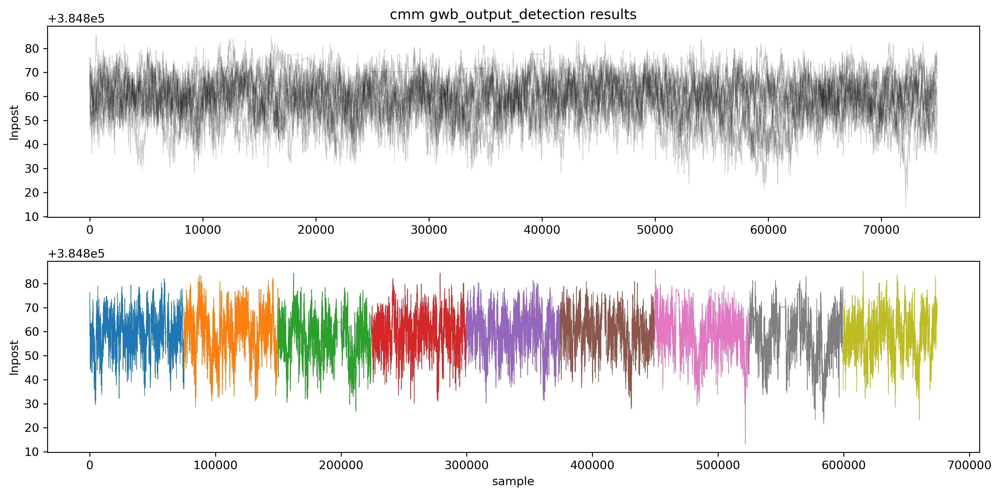

In [31]:
nchains = plot_post_and_set_burn(cs, nchains, fig_savedir=None,
                                 min_burn=2000, max_burn=30000)

In [32]:
dg.plot_chains(cs, hist=True, ncols=5)

In [34]:
# make core with all cores together
chains = []
for ci in cs:
    chains.append(ci.chain[ci.burn::])
chain_array = np.concatenate(chains)
c = co.Core(chain=chain_array, label=cs[0].label,
            params=cs[0].params, pt_chains=False, burn=0)

In [37]:
c.save(f'{coresave}/core.h5')

In [91]:
c = co.Core(corepath=f'{coresave}/core.h5', burn=0)

Text(0.5, 1.0, 'Detection (log-uniform) prior')

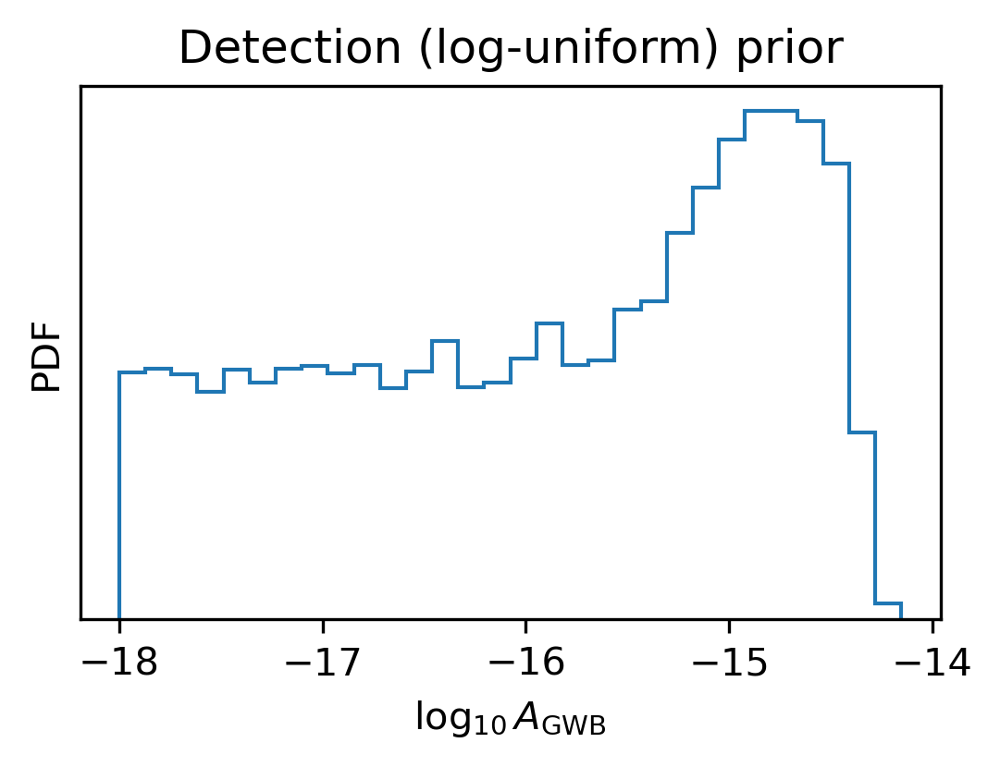

In [93]:
# Reproduce the figure
#upper_limit = 10**c.get_param_credint('gwb_log10_A', onesided=True, interval=95)
fig, ax = plt.subplots(figsize=(4,2.5))
ax.hist(c('gwb_log10_A'), histtype='step', density=True, bins=30)
#ax.axvline(np.log10(upper_limit), linestyle='dashed', color='k')
ax.set_xlabel(r'$\log_{10}A_{\rm{GWB}}$')
ax.set_ylabel('PDF')
ax.set_yticks([])
ax.set_title('Detection (log-uniform) prior')

So we are using RN + DMGP + DM annual process + 13/3 GWB. GWB doesn't look very significant, most DM anuual processes do not either.

Next check out `gwb_output`

In [94]:
label = 'gwb_output'
chaindir = f'/gpfs/gibbs/project/mingarelli/cmm323/eccentricity/{label}'
coresave = f'/gpfs/gibbs/project/mingarelli/bbl29/IPTA_DR2_analysis/cmm_DR2lite/{label}'
chaindirs = glob.glob(f'{chaindir}/more*')

 10%|█         | 1/10 [00:03<00:30,  3.42s/it]

99900


 20%|██        | 2/10 [00:06<00:27,  3.43s/it]

99900


 30%|███       | 3/10 [00:10<00:24,  3.43s/it]

99900


 40%|████      | 4/10 [00:13<00:20,  3.43s/it]

99900


 50%|█████     | 5/10 [00:17<00:17,  3.45s/it]

99900


 60%|██████    | 6/10 [00:20<00:13,  3.45s/it]

99900


 70%|███████   | 7/10 [00:24<00:10,  3.44s/it]

99900


 80%|████████  | 8/10 [00:27<00:06,  3.50s/it]

99900


 90%|█████████ | 9/10 [00:31<00:03,  3.47s/it]

99900


100%|██████████| 10/10 [00:34<00:00,  3.46s/it]

99900
burns: [24975, 24975, 24975, 24975, 24975, 24975, 24975, 24975, 24975, 24975]
999000 total samples
749250 samples after burn in
25.0 % of samples burned


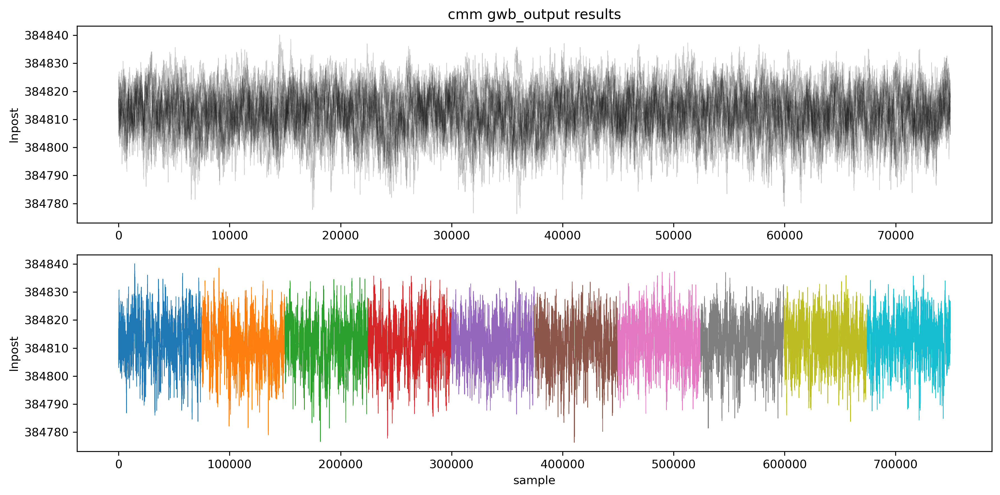

In [39]:
cs = []
for cd in tqdm.tqdm(chaindirs):
    #if i == 0:
    #    continue
    #print(f'{i+1}/{nchains}')
    try:
        #core = co.Core(label=f'{psrname} {anm_type} basis hm', chaindir=cd, pt_chains=True)
        core = co.Core(label=f'cmm {label} results', chaindir=cd)
        # load weights
        if len(core.chain) > 200:
            #print(len(core.chain))
            cs.append(core)
        else:
            print(f'Core from {cd} has too few samples')
    except Exception as e:
        print(f'could not load from {cd}')
        print(f'Exception: {e}')
nchains = len(cs)
if nchains == 0:
    print(f'Not enough samples for {psrname}!!')
nchains = plot_post_and_set_burn(cs, nchains, fig_savedir=None,
                                 min_burn=2000, max_burn=30000)

In [40]:
dg.plot_chains(cs, hist=True, ncols=5)

In [43]:
# make core with all cores together
chains = []
for ci in cs:
    chains.append(ci.chain[ci.burn::])
chain_array = np.concatenate(chains)
c = co.Core(chain=chain_array, label=cs[0].label,
            params=cs[0].params, pt_chains=False, burn=0)
if not os.path.isdir(coresave):
    os.mkdir(coresave)
c.save(f'{coresave}/core.h5')

In [95]:
c = co.Core(corepath=f'{coresave}/core.h5', burn=0)

Text(0.5, 1.0, 'Upper limit $A_{\\rm{GWB}}^{95\\%} = $2.1$\\times10^{-15}$')

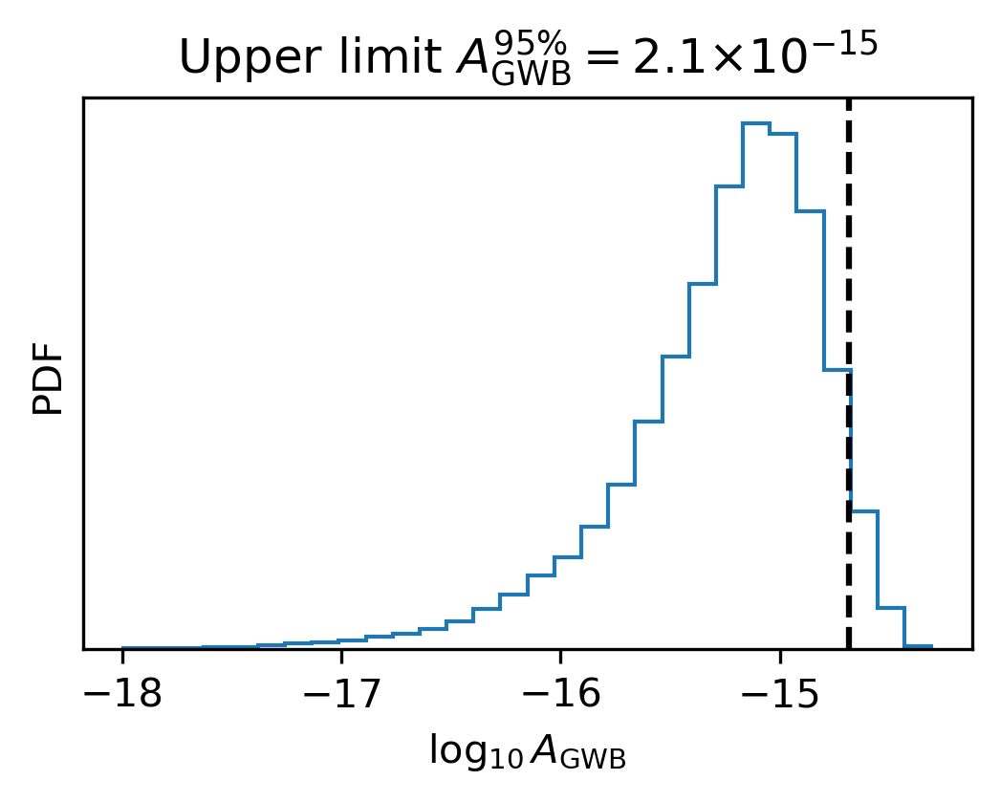

In [96]:
# Reproduce the figure
upper_limit = 10**c.get_param_credint('gwb_log10_A', onesided=True, interval=95)
fig, ax = plt.subplots(figsize=(4,2.5))
ax.hist(c('gwb_log10_A'), histtype='step', density=True, bins=30)
ax.axvline(np.log10(upper_limit), linestyle='dashed', color='k')
ax.set_xlabel(r'$\log_{10}A_{\rm{GWB}}$')
ax.set_ylabel('PDF')
ax.set_yticks([])
ax.set_title(r'Upper limit $A_{\rm{GWB}}^{95\%} = $'+f'{np.round(upper_limit*1e15, decimals=1)}'+
             r'$\times10^{-15}$')

Text(0.5, 1.0, 'Upper limit $A_{\\rm{GWB}}^{95\\%} = $2.1$\\times10^{-15}$')

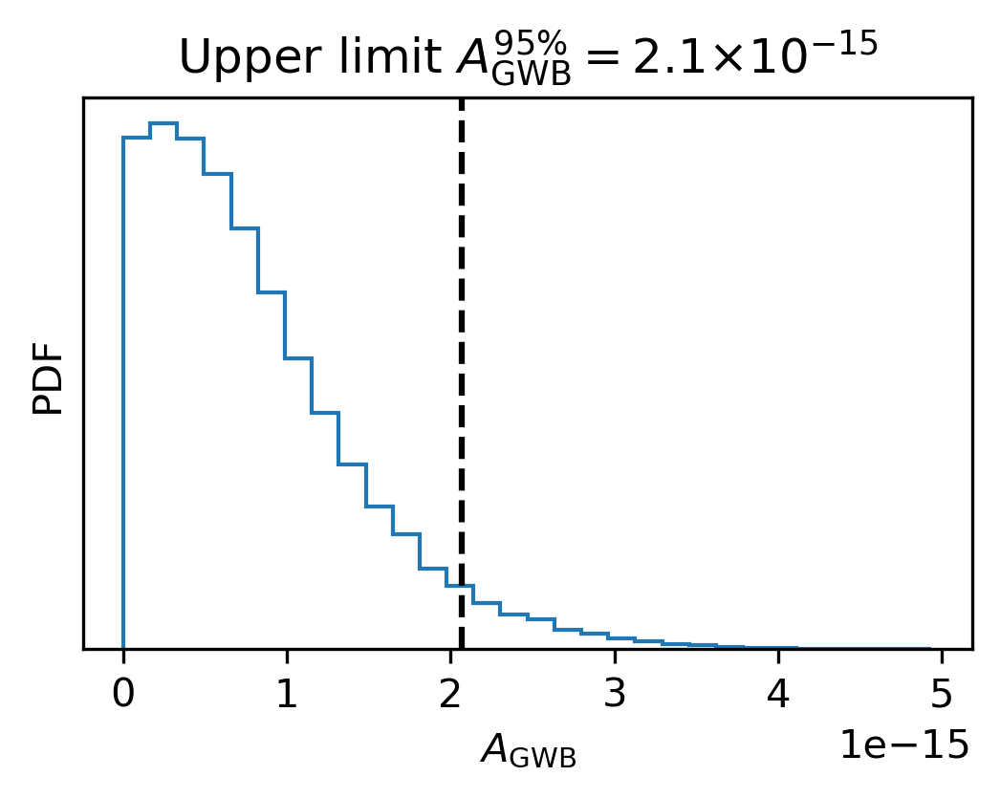

In [97]:
# Transform to a uniform distribution
fig, ax = plt.subplots(figsize=(4,2.5))
ax.hist(10**c('gwb_log10_A'), histtype='step', density=True, bins=30)
ax.axvline(upper_limit, linestyle='dashed', color='k')
ax.set_xlabel(r'$A_{\rm{GWB}}$')
ax.set_ylabel('PDF')
ax.set_yticks([])
ax.set_title(r'Upper limit $A_{\rm{GWB}}^{95\%} = $'+f'{np.round(upper_limit*1e15, decimals=1)}'+
             r'$\times10^{-15}$')

So it looks like the same model, but with an exponential prior on `gwb_log10_A` rather than uniform. We have recovered exactly the same upper limit plot and value as what's in the paper.

It turns out there is nothing in `gwb_output_detection_2023`. Finally let's look at `gwb_output_detection_Astro`

In [108]:
label = 'gwb_output_detection_Astro'
chaindir = f'/gpfs/gibbs/project/mingarelli/cmm323/eccentricity/{label}'
coresave = f'/gpfs/gibbs/project/mingarelli/bbl29/IPTA_DR2_analysis/cmm_DR2lite/{label}'
chaindirs = glob.glob(f'{chaindir}/more*')

100%|██████████| 9/9 [00:31<00:00,  3.48s/it]


burns: [24975, 24975, 24975, 24975, 24975, 24975, 24975, 24975, 24975]
899100 total samples
674325 samples after burn in
25.0 % of samples burned


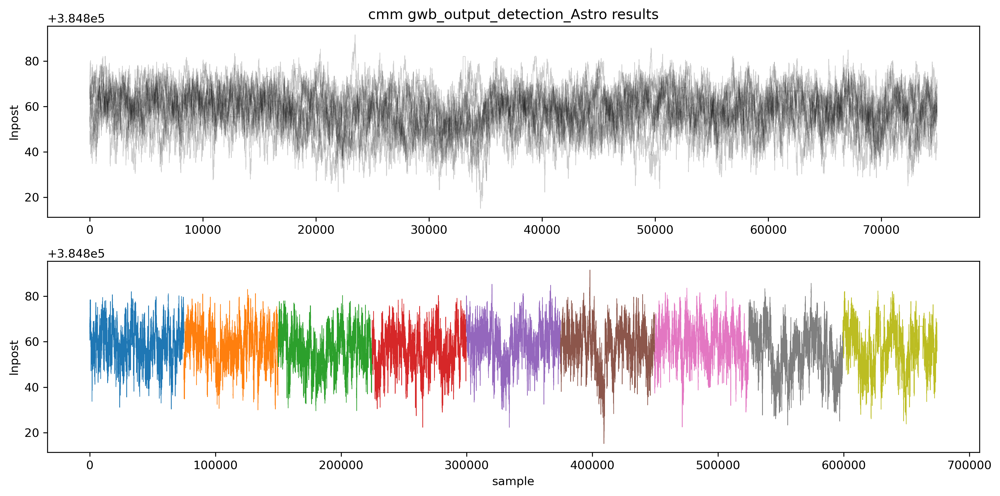

In [109]:
cs = []
for cd in tqdm.tqdm(chaindirs):
    #if i == 0:
    #    continue
    #print(f'{i+1}/{nchains}')
    try:
        #core = co.Core(label=f'{psrname} {anm_type} basis hm', chaindir=cd, pt_chains=True)
        core = co.Core(label=f'cmm {label} results', chaindir=cd)
        # load weights
        if len(core.chain) > 200:
            #print(len(core.chain))
            cs.append(core)
        else:
            print(f'Core from {cd} has too few samples')
    except Exception as e:
        print(f'could not load from {cd}')
        print(f'Exception: {e}')
nchains = len(cs)
if nchains == 0:
    print(f'Not enough samples for {psrname}!!')
nchains = plot_post_and_set_burn(cs, nchains, fig_savedir=None,
                                 min_burn=2000, max_burn=30000)

In [110]:
dg.plot_chains(cs, hist=True, ncols=5)

In [111]:
# make core with all cores together
chains = []
for ci in cs:
    chains.append(ci.chain[ci.burn::])
chain_array = np.concatenate(chains)
c = co.Core(chain=chain_array, label=cs[0].label,
            params=cs[0].params, pt_chains=False, burn=0)
if not os.path.isdir(coresave):
    os.mkdir(coresave)
c.save(f'{coresave}/core.h5')

Text(0.5, 1.0, 'Astro motivated detection prior')

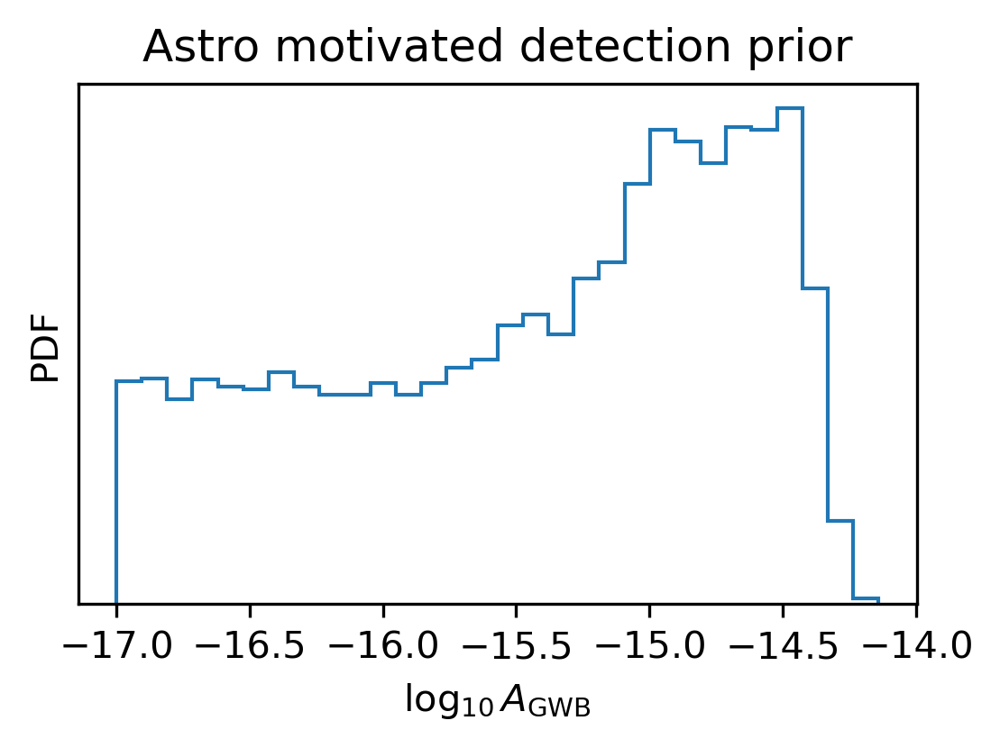

In [113]:
# Reproduce the figure
#upper_limit = 10**c.get_param_credint('gwb_log10_A', onesided=True, interval=95)
fig, ax = plt.subplots(figsize=(4,2.5))
ax.hist(c('gwb_log10_A'), histtype='step', density=True, bins=30)
#ax.axvline(np.log10(upper_limit), linestyle='dashed', color='k')
ax.set_xlabel(r'$\log_{10}A_{\rm{GWB}}$')
ax.set_ylabel('PDF')
ax.set_yticks([])
ax.set_title('Astro motivated detection prior')

So the model is the same as the first detection run, except the prior is more constrained.

Finally, let's compare all parameters head to head

In [115]:
labels = ['gwb_output', 'gwb_output_detection', 'gwb_output_detection_Astro']
corepath_basename = f'/gpfs/gibbs/project/mingarelli/bbl29/IPTA_DR2_analysis/cmm_DR2lite'
cs = [co.Core(corepath=f'{corepath_basename}/{label}/core.h5') for label in labels]

In [116]:
legend_labels = ['Upper limit prior','Detection prior','Astro/Detection prior']
dg.plot_chains(cs, hist=True, ncols=5, legend_labels=legend_labels)

Based on the differences to red noise, I assume the red noise is getting uniform priors applied in the upper limit run as well